# **Nepali Sign Language Characters Classification**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Table of Contents**

1. [Import and Dependencies](#1-import-and-dependencies)
2. [Data Parsing and Configuration](#2-data-parsing-and-configuration)
3. [Dataset Statistics and Verification](#3-dataset-statistics-and-verification)
4. [Data Visualization](#4-data-visualization)
5. [Dataset Loading and Augmentation](#5-dataset-loading-and-augmentation)
    - [Data Augmentation](#51-data-augmentation)
    - [Data Augmentation Visualization](#52-data-augmentation-visualization)
6. [Dataset Preparation for Training](#6-dataset-preparation-for-training)
7. [MobileNetv2](#7-mobilenetv2)
    - [Model Training](#71-model-training)
    - [Model Evaluation](#72-model-evaluation)
    - [Model Inference](#73-model-inference)
        - [Single Inference](#731-single-inference)
        - [Batch Inference](#732-batch-inference)
8. [ResNet50](#8-resnet50)
    - [Model Training](#81-model-training)
    - [Model Evaluation](#82-model-evaluation)
    - [Model Inference](#83-model-inference)
        - [Single Inference](#831-single-inference)
        - [Batch Inference](#832-batch-inference)

*Note: Clickable links in a custom markdown table of contents do not work in Google Colab, please use the built-in Table of contents sidebar instead.*

## **1. Import and Dependencies**

In [2]:
!pip install matplotlib tensorflow

In [3]:
import os
import random
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.layers import RandomRotation
from tensorflow.keras import layers, applications, Model, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array

## **2. Data Parsing and Configuration**

In [4]:
def parse_tfrecord(example_proto):
    feature_description = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "label": tf.io.FixedLenFeature([], tf.int64),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)
    image = tf.image.decode_jpeg(example["image"], channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)
    label = example["label"]
    return image, label

In [5]:
train_tfrecord="/content/drive/MyDrive/tfrecords/train.tfrecord"
val_tfrecord="/content/drive/MyDrive/tfrecords/val.tfrecord"
test_tfrecord="/content/drive/MyDrive/tfrecords/test.tfrecord"

num_classes = 36
classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]

## **3. Dataset Statistics and Verification**

In [6]:
# counting the number of images
len_train = tf.data.TFRecordDataset(train_tfrecord)
len_val = tf.data.TFRecordDataset(val_tfrecord)
len_test = tf.data.TFRecordDataset(test_tfrecord)

count_1 = sum(1 for _ in len_train)
count_2 = sum(1 for _ in len_val)
count_3 = sum(1 for _ in len_test)

print("Number of images in the TFRecord:", count_1, count_2, count_3)

Number of images in the TFRecord: 37800 8100 8100


## **4. Data Visualization**

In [7]:
# Sample 10 random images from each class
def sample_images(dataset, num_classes, num_samples=10):
    class_images = {i: [] for i in range(num_classes)}

    # Collect images for each class
    for image, label in dataset:
        label = int(label.numpy())
        if len(class_images[label]) < num_samples:
            class_images[label].append(image)
        if all(len(images) == num_samples for images in class_images.values()):
            break  # Stop if we have enough samples for all classes

    return class_images

def visualize_samples(class_images, num_samples=10):
    for label, images in class_images.items():
        print(f"Class {label}:")
        fig, axes = plt.subplots(1, num_samples, figsize=(20, 5))
        for i, img in enumerate(images):
            # Convert TensorFlow Tensor to NumPy array and normalize pixel values
            img_array = img.numpy()
            if img_array.dtype == float:  # Normalize if in range [0, 1]
                img_array = (img_array * 255).astype("uint8")
            axes[i].imshow(img_array)
            axes[i].axis("off")
        plt.show()

## **5. Dataset Loading and Augmentation**

In [8]:
def load_dataset(tfrecord_file, augment=False, include_tags=False): #including tags only for visualization purposes
    raw_dataset = tf.data.TFRecordDataset(tfrecord_file)
    parsed_dataset = raw_dataset.map(parse_tfrecord)

    if augment:
        if include_tags:
            parsed_dataset = parsed_dataset.map(apply_augmentations_with_tags, num_parallel_calls=tf.data.AUTOTUNE)
        else:
            parsed_dataset = parsed_dataset.map(apply_augmentations, num_parallel_calls=tf.data.AUTOTUNE)

    return parsed_dataset

Class 0:


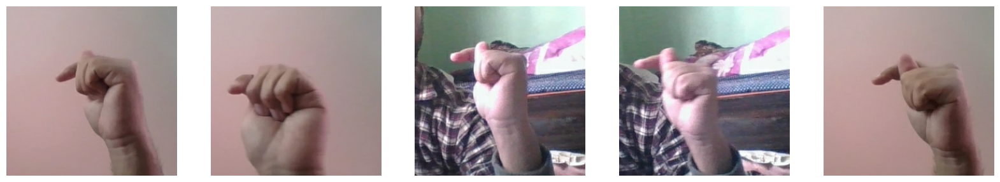

Class 1:


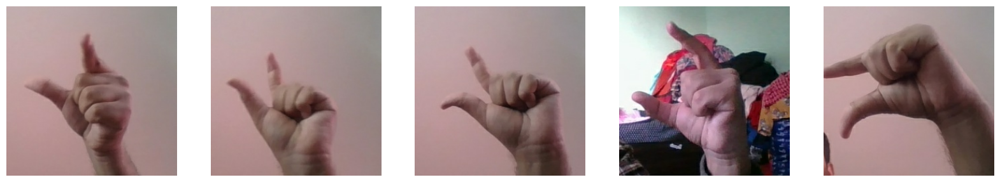

Class 2:


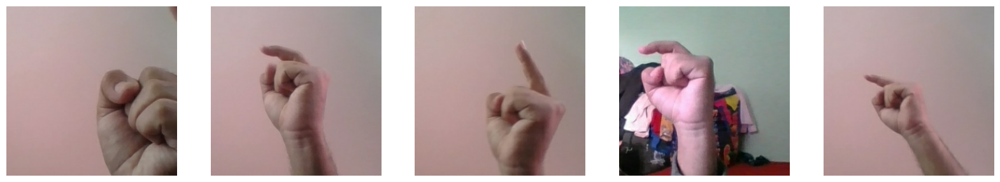

Class 3:


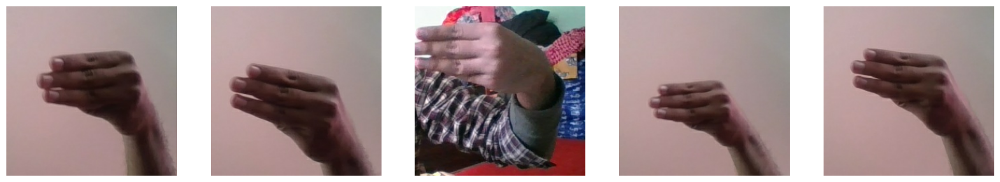

Class 4:


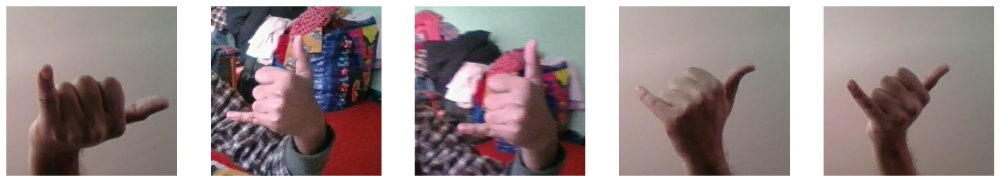

Class 5:


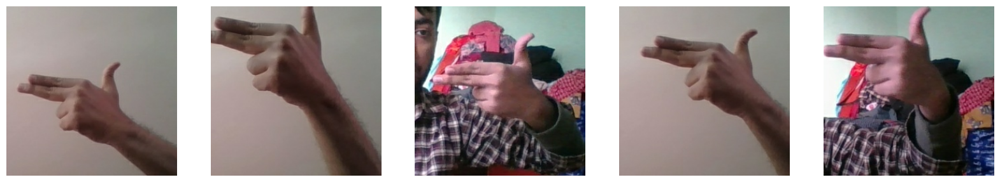

Class 6:


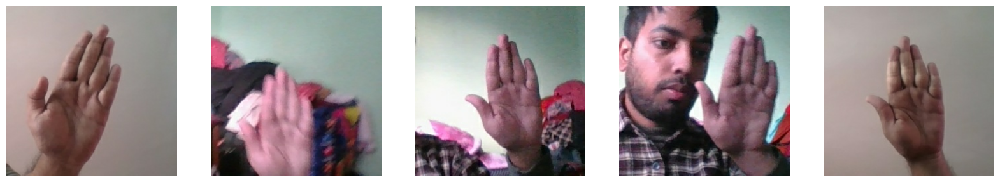

Class 7:


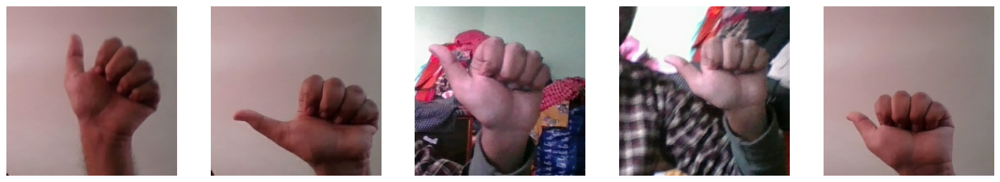

Class 8:


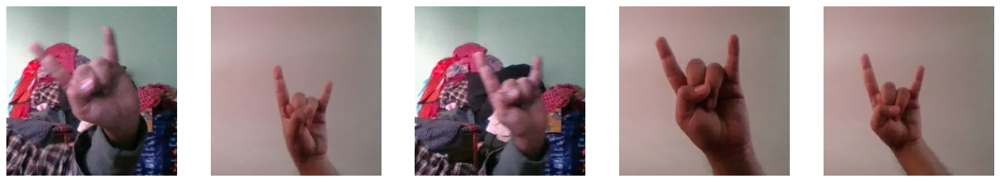

Class 9:


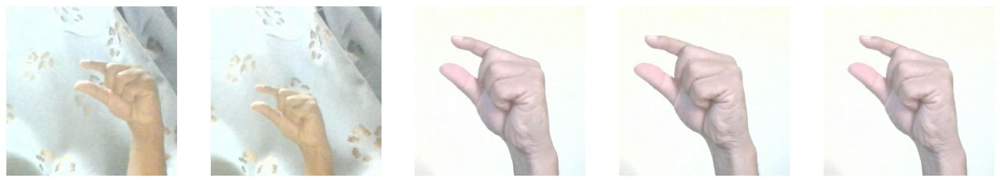

Class 10:


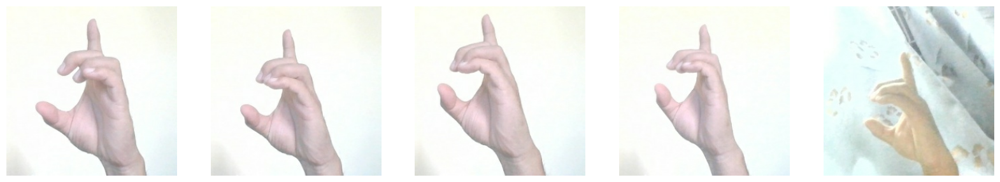

Class 11:


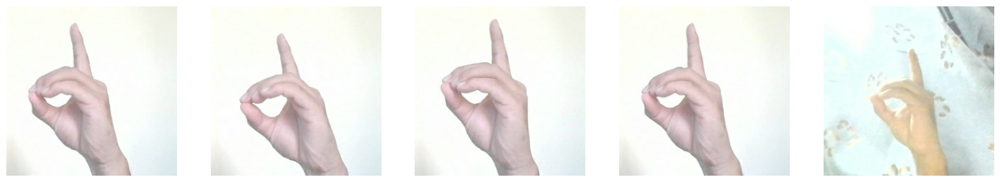

Class 12:


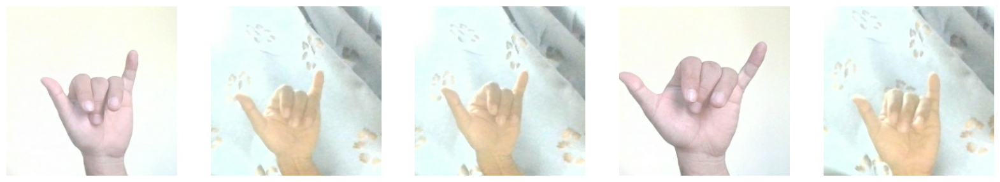

Class 13:


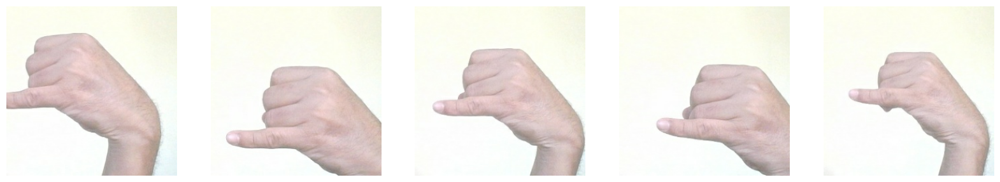

Class 14:


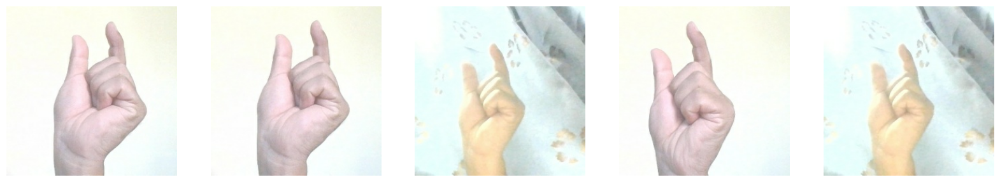

Class 15:


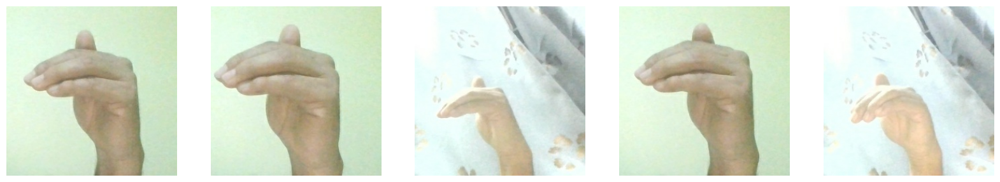

Class 16:


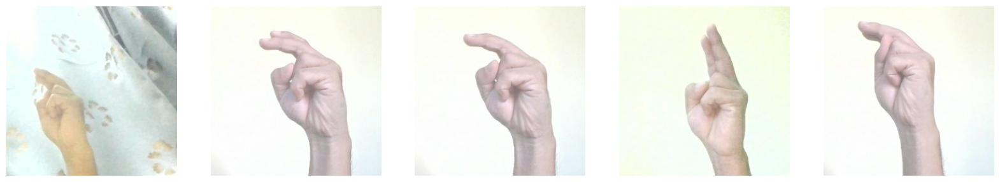

Class 17:


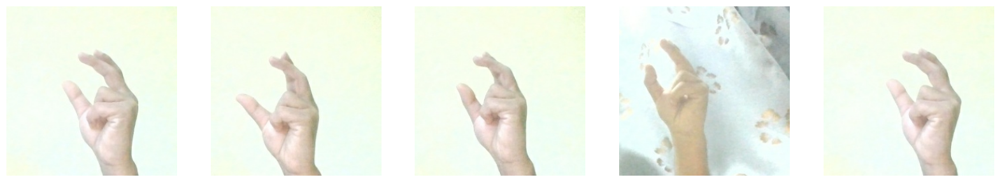

Class 18:


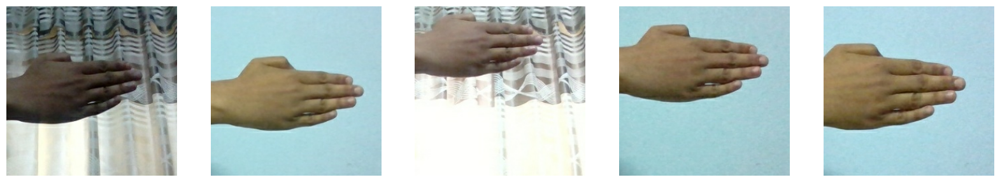

Class 19:


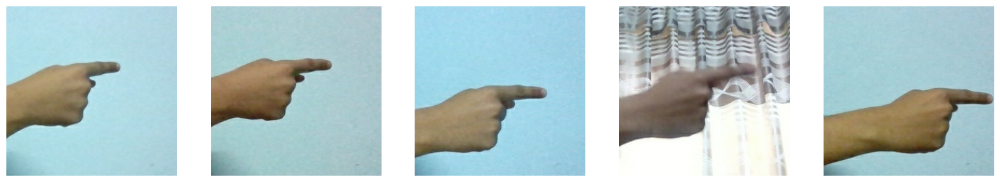

Class 20:


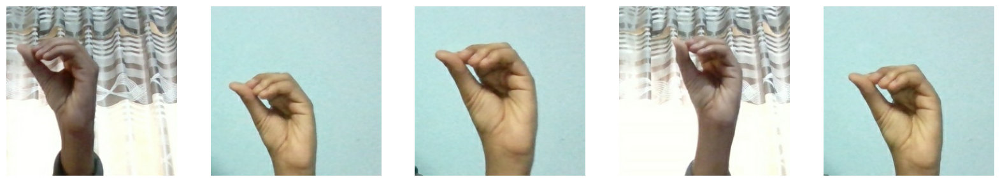

Class 21:


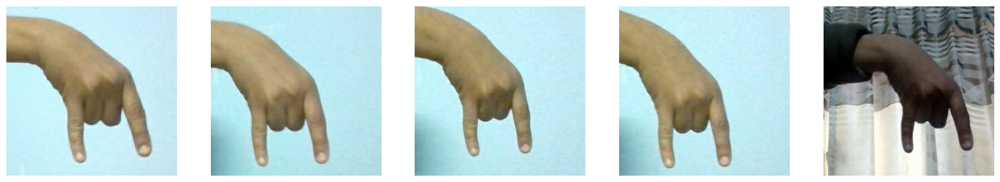

Class 22:


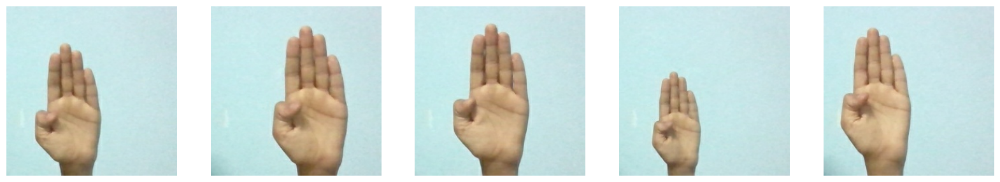

Class 23:


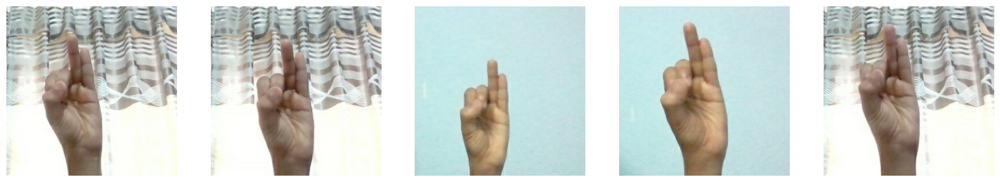

Class 24:


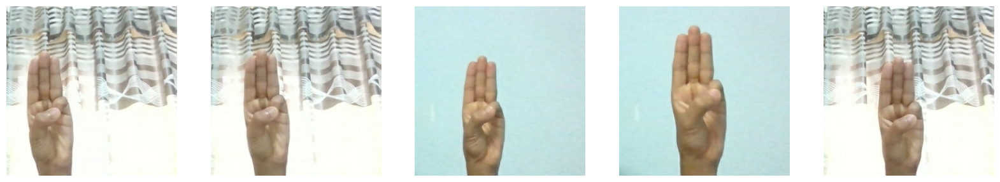

Class 25:


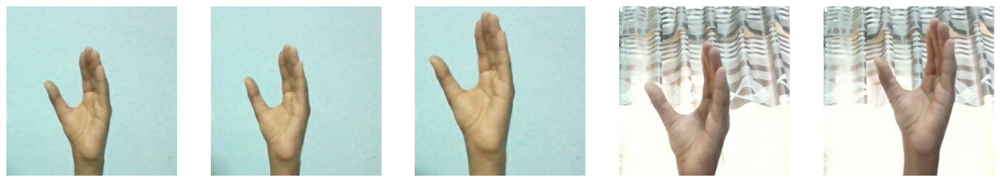

Class 26:


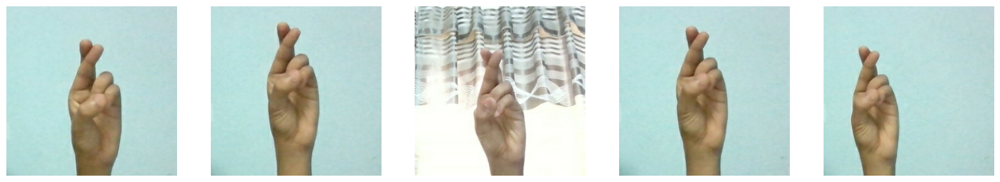

Class 27:


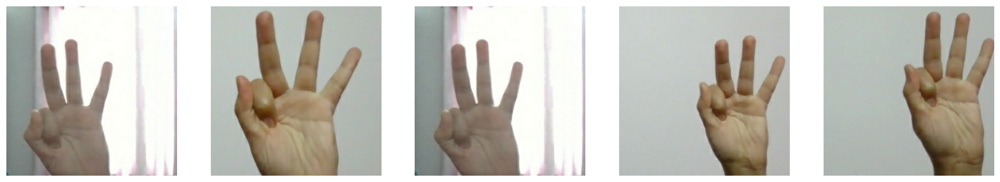

Class 28:


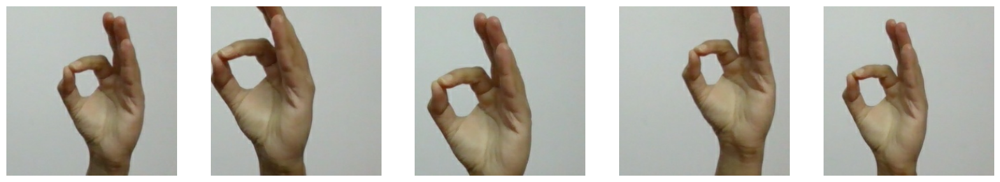

Class 29:


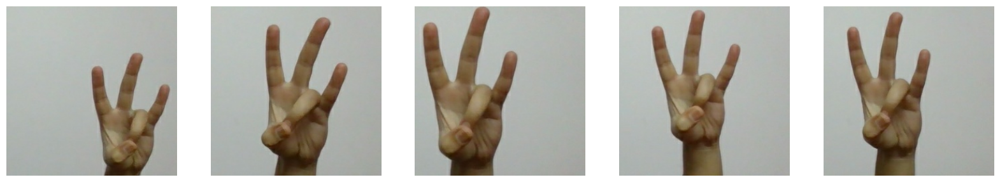

Class 30:


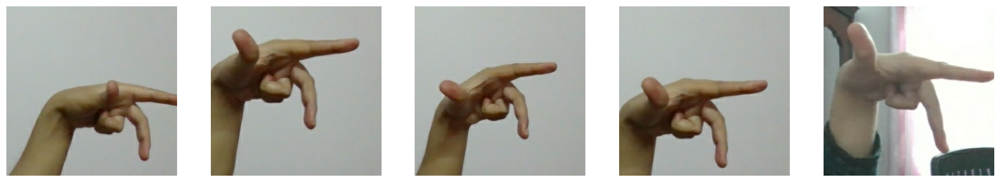

Class 31:


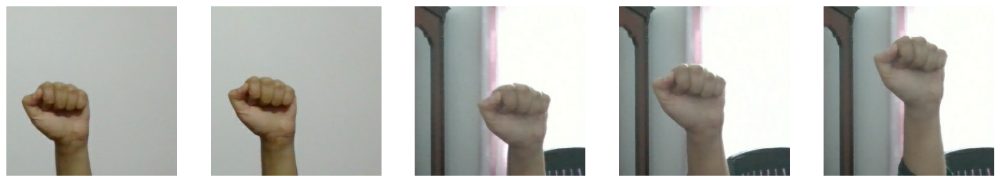

Class 32:


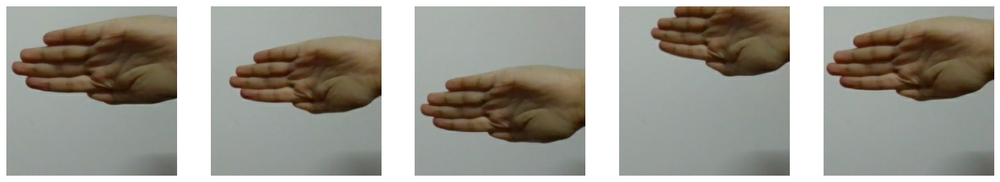

Class 33:


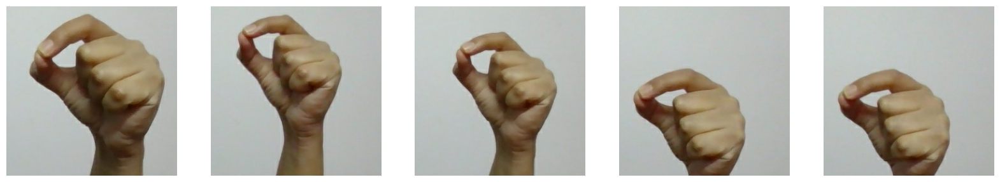

Class 34:


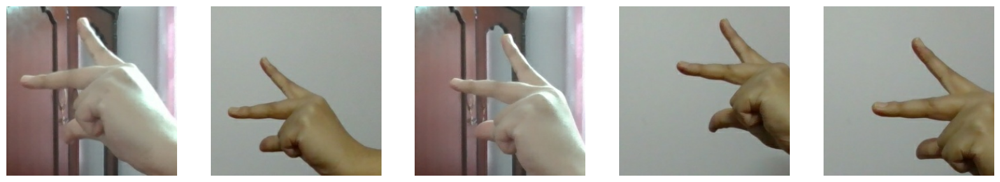

Class 35:


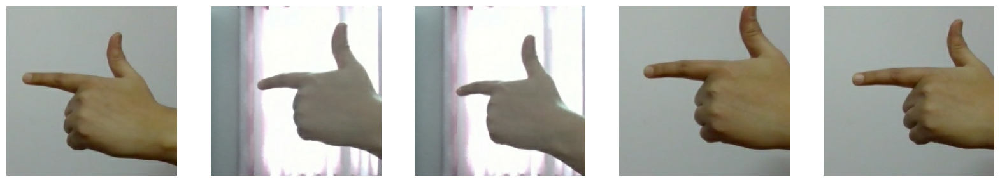

In [9]:
NUM_SAMPLES = 5

dataset = load_dataset(train_tfrecord)
class_images = sample_images(dataset, num_classes, NUM_SAMPLES)
visualize_samples(class_images, NUM_SAMPLES)

### **5.1 Data Augmentation**

In [10]:
tf.random.set_seed(42)
random_rotation = RandomRotation(factor=(-30 / 360, 30 / 360), fill_mode='reflect')

def apply_augmentations(image, label):
    image = tf.image.convert_image_dtype(image, dtype=tf.float32)
    # Random horizontal flip (30% probability)
    if tf.random.uniform([], seed=42) < 0.35:
        image = tf.image.flip_left_right(image)
    # Random contrast adjustment (5% probability)
    if tf.random.uniform([], seed=42) < 0.05:
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
    # Random rotation (-30 to 30 degrees, 20% probability)
    if tf.random.uniform([], seed =42) < 0.25:
        image = random_rotation(image)
    return image, label

In [11]:
def apply_augmentations_with_tags(image, label):
    image = tf.image.convert_image_dtype(image, dtype=tf.float32)
    tag = "original"
    # Random horizontal flip (30% probability)
    if tf.random.uniform([], seed=42) < 0.35:
        image = tf.image.flip_left_right(image)
        tag="flipped"
    # Random contrast adjustment (5% probability)
    if tf.random.uniform([], seed=42) < 0.05:
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
        tag="rotated"
    # Random rotation (-30 to 30 degrees, 20% probability)
    if tf.random.uniform([], seed =42) < 0.25:
        image = random_rotation(image)
    return image, label, tag


### **5.2 Data Augmentation Visualization**


In [12]:
def visualize_specific_augmentation(dataset, augmentation_tag, num_images):
    count = 0
    plt.figure(figsize=(12, 12))

    for image, label, tag in dataset.take(num_images * 2):  # Take extra to account for filtering
        if tag.numpy().decode("utf-8") == augmentation_tag:
            plt.subplot(5, 5, count + 1)
            plt.imshow(image.numpy())
            plt.title(f"Label: {label.numpy()}, Tag: {tag.numpy().decode('utf-8')}")
            plt.axis("off")
            count += 1
            if count >= num_images:
                break
    plt.tight_layout()
    plt.show()

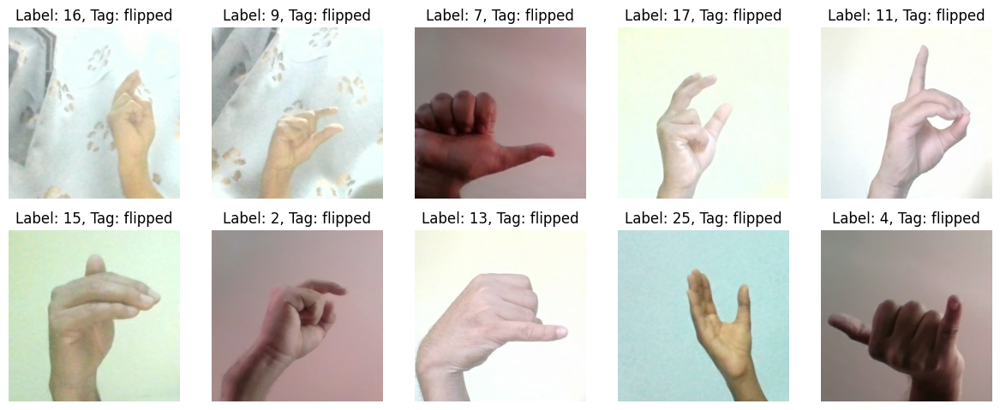

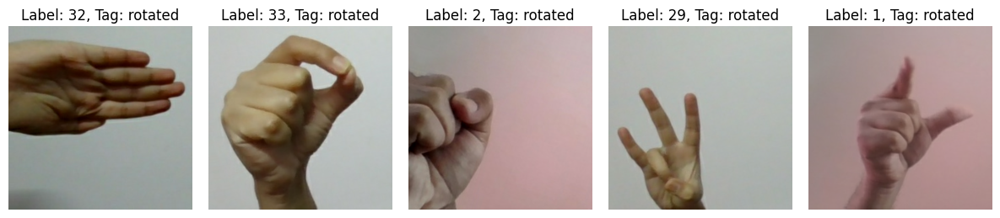

In [13]:
debug_dataset = load_dataset(train_tfrecord, augment=True, include_tags=True).batch(1)
visualize_specific_augmentation(debug_dataset.unbatch(), augmentation_tag="flipped", num_images=20)
visualize_specific_augmentation(debug_dataset.unbatch(), augmentation_tag="rotated", num_images=20)

## **6. Dataset Preparation for Training**

In [14]:
# With augmentations for training
train_dataset = load_dataset(train_tfrecord, augment=True)
train_dataset = train_dataset.shuffle(1024).batch(32).prefetch(tf.data.AUTOTUNE).repeat()

# Without augmentations for validation or test
val_dataset = load_dataset(val_tfrecord, augment=False)
val_dataset = val_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

test_dataset = load_dataset(test_tfrecord, augment=False)
test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

## **7. MobileNetv2**

### **7.1 Model Training**

In [ ]:
base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(256, 256, 3), include_top=False, weights='imagenet', alpha = 0.5)
base_model.trainable = False

/tmp/ipython-input-1047083484.py:1: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(256, 256, 3), include_top=False, weights='imagenet', alpha = 0.5)


3201480/3201480 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
model = tf.keras.Sequential([
base_model,
tf.keras.layers.GlobalAveragePooling2D(),
tf.keras.layers.Dense(256, activation='relu'),
tf.keras.layers.Dropout(0.5),
tf.keras.layers.Dense(128, activation='relu'),
tf.keras.layers.Dropout(0.3),
tf.keras.layers.Dense(num_classes, activation='softmax')
])

In [ ]:
model.summary(show_trainable=True)

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ mobilenetv2_0.50_224        │ (None, 8, 8, 1280)    │    706,224 │   N   │
│ (Functional)                │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 1280)          │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 256)           │    327,936 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 256)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 128)           │     32,896 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout_1 (Dropout)         │ (None, 128)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_2 (Dense)             │ (None, 36)            │      4,644 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 1,071,700 (4.09 MB)

 Trainable params: 365,476 (1.39 MB)

 Non-trainable params: 706,224 (2.69 MB)

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [ ]:
total_history = []

In [ ]:
history = model.fit(train_dataset, steps_per_epoch=1180, epochs=10, validation_data=val_dataset)
total_history.append(history)

Epoch 1/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 169s 123ms/step - accuracy: 0.5673 - loss: 1.4485 - val_accuracy: 0.9640 - val_loss: 0.1442
Epoch 2/10
   1/1180 ━━━━━━━━━━━━━━━━━━━━ 43s 37ms/step - accuracy: 0.8125 - loss: 0.3836

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 185s 157ms/step - accuracy: 0.8079 - loss: 0.6445 - val_accuracy: 0.9673 - val_loss: 0.1182
Epoch 3/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 124s 105ms/step - accuracy: 0.8239 - loss: 0.6160 - val_accuracy: 0.9678 - val_loss: 0.1010
Epoch 4/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 121s 103ms/step - accuracy: 0.8478 - loss: 0.5530 - val_accuracy: 0.9895 - val_loss: 0.0529
Epoch 5/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 122s 103ms/step - accuracy: 0.8588 - loss: 0.5368 - val_accuracy: 0.9806 - val_loss: 0.0672
Epoch 6/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 121s 102ms/step - accuracy: 0.8539 - loss: 0.5678 - val_accuracy: 0.9852 - val_loss: 0.0644
Epoch 7/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 119s 101ms/step - accuracy: 0.8632 - loss: 0.5398 - val_accuracy: 0.9857 - val_loss: 0.0701
Epoch 8/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 121s 102ms/step - accuracy: 0.8709 - loss: 0.5558 - val_accuracy: 0.9899 - val_loss: 0.0472
Epoch 9/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 132s 112ms/step - accuracy: 0.8

In [ ]:
print(len(base_model.layers))

154


In [ ]:
for layer in base_model.layers[140:]:
  layer.trainable = True

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [ ]:
history = model.fit(train_dataset, steps_per_epoch=1180, epochs=10, validation_data=val_dataset)
total_history.append(history)

Epoch 1/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 154s 115ms/step - accuracy: 0.6262 - loss: 1.8859 - val_accuracy: 0.9685 - val_loss: 0.1137
Epoch 2/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 193s 164ms/step - accuracy: 0.7579 - loss: 0.9847 - val_accuracy: 0.9762 - val_loss: 0.0965
Epoch 3/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 129s 109ms/step - accuracy: 0.8124 - loss: 0.7501 - val_accuracy: 0.9820 - val_loss: 0.0747
Epoch 4/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 126s 107ms/step - accuracy: 0.8430 - loss: 0.6100 - val_accuracy: 0.9849 - val_loss: 0.0661
Epoch 5/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 134s 114ms/step - accuracy: 0.8592 - loss: 0.5342 - val_accuracy: 0.9865 - val_loss: 0.0581
Epoch 6/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 124s 105ms/step - accuracy: 0.8699 - loss: 0.4796 - val_accuracy: 0.9881 - val_loss: 0.0506
Epoch 7/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 124s 105ms/step - accuracy: 0.8879 - loss: 0.4345 - val_accuracy: 0.9889 - val_loss: 0.0470
Epoch 8/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 139s 118ms/step - ac

In [ ]:
model_dir="/content/drive/MyDrive/tfrecords/mbnet.keras"
model.save(model_dir)

### **7.2 Model Evaluation**

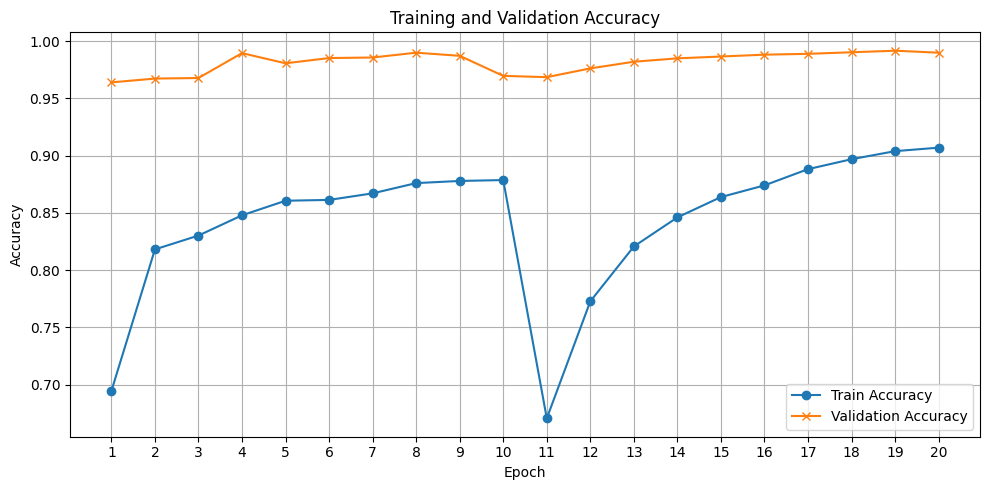

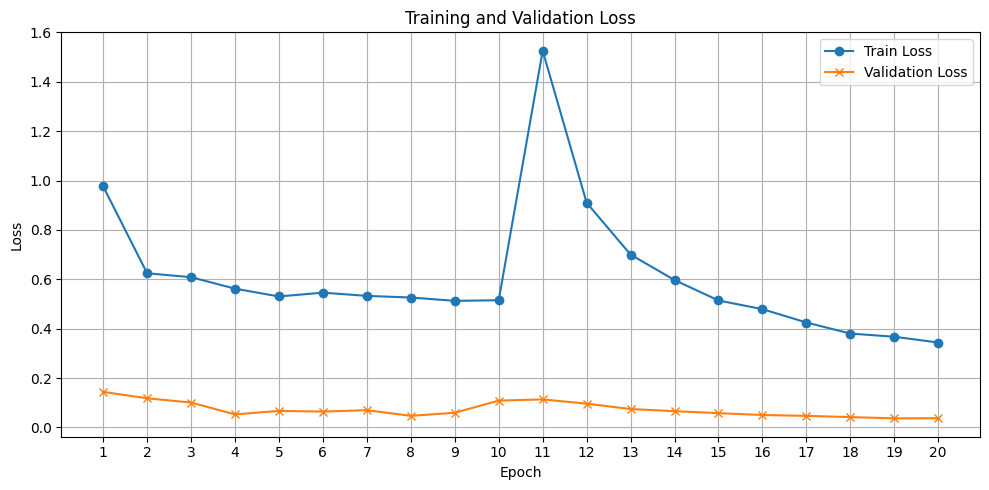

In [ ]:
# Initialize lists
train_acc = []
val_acc = []
train_loss = []
val_loss = []
epochs = []

epoch_counter = 0

# Loop through each training history
for history in total_history:
    acc = history.history['accuracy']
    val = history.history['val_accuracy']
    loss = history.history['loss']
    val_l = history.history['val_loss']
    n = len(acc)

    train_acc.extend(acc)
    val_acc.extend(val)
    train_loss.extend(loss)
    val_loss.extend(val_l)
    epochs.extend(range(epoch_counter + 1, epoch_counter + n + 1))

    epoch_counter += n

# Plot Accuracy
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, len(epochs) + 1, 1))
plt.tight_layout()
plt.show()

# Plot Loss
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, len(epochs) + 1, 1))
plt.tight_layout()
plt.show()


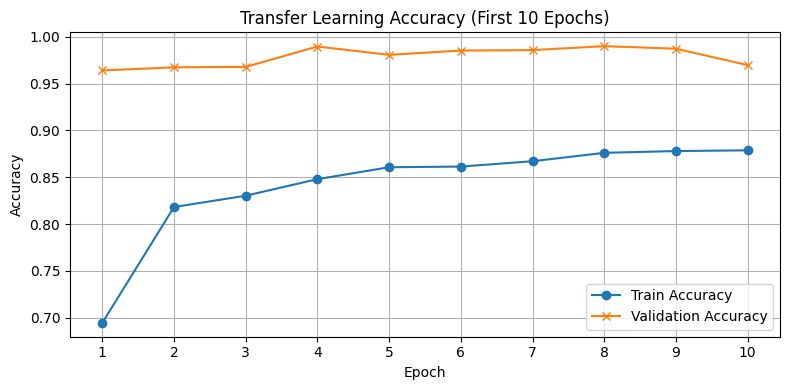

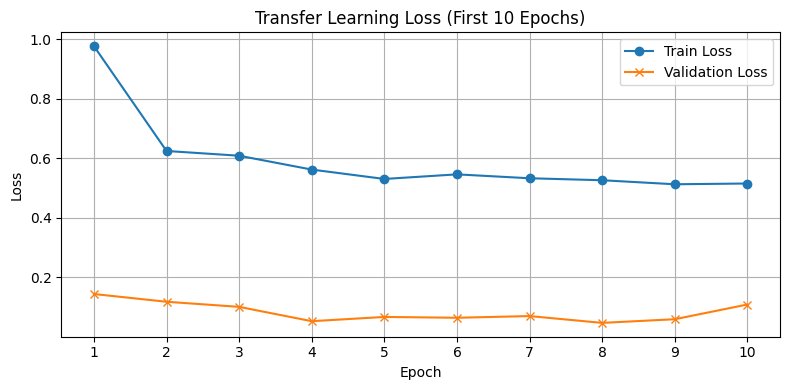

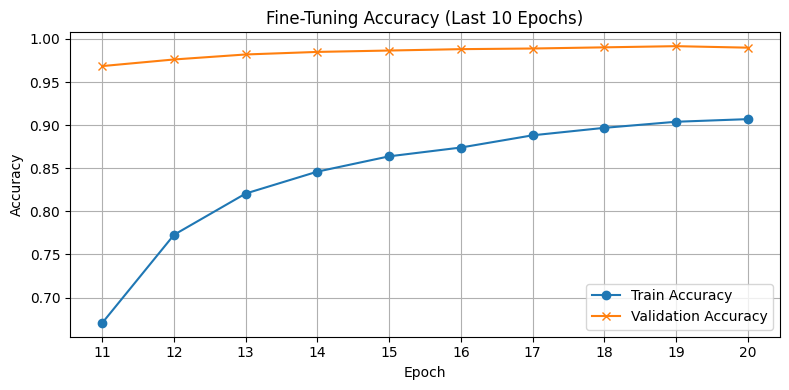

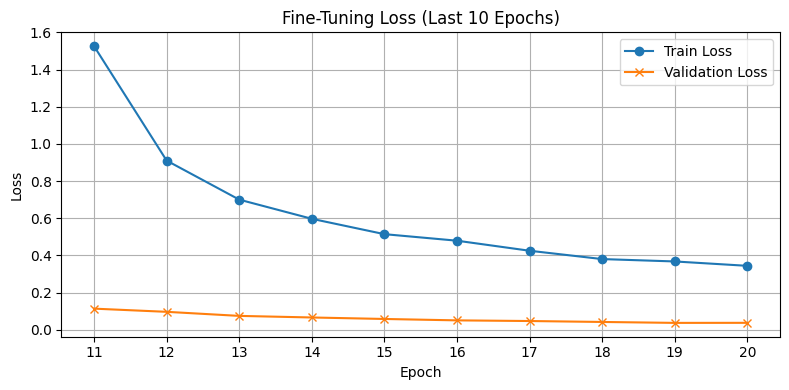

In [ ]:
# Seperate plots for transfer learning and fine-tuning
# Split into two phases
split_epoch = 10  # first 10 transfer learning, next 10 fine-tuning

train_acc_phase1 = train_acc[:split_epoch]
val_acc_phase1 = val_acc[:split_epoch]
train_loss_phase1 = train_loss[:split_epoch]
val_loss_phase1 = val_loss[:split_epoch]

train_acc_phase2 = train_acc[split_epoch:]
val_acc_phase2 = val_acc[split_epoch:]
train_loss_phase2 = train_loss[split_epoch:]
val_loss_phase2 = val_loss[split_epoch:]

epochs_phase1 = epochs[:split_epoch]
epochs_phase2 = epochs[split_epoch:]

# Plot Phase 1 - Accuracy
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase1, train_acc_phase1, label='Train Accuracy', marker='o')
plt.plot(epochs_phase1, val_acc_phase1, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Transfer Learning Accuracy (First 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, split_epoch + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 1 - Loss
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase1, train_loss_phase1, label='Train Loss', marker='o')
plt.plot(epochs_phase1, val_loss_phase1, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Transfer Learning Loss (First 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, split_epoch + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 2 - Accuracy
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase2, train_acc_phase2, label='Train Accuracy', marker='o')
plt.plot(epochs_phase2, val_acc_phase2, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Fine-Tuning Accuracy (Last 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(split_epoch+1, split_epoch*2 + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 2 - Loss
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase2, train_loss_phase2, label='Train Loss', marker='o')
plt.plot(epochs_phase2, val_loss_phase2, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Fine-Tuning Loss (Last 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(split_epoch+1, split_epoch*2 + 1, 1))
plt.tight_layout()
plt.show()


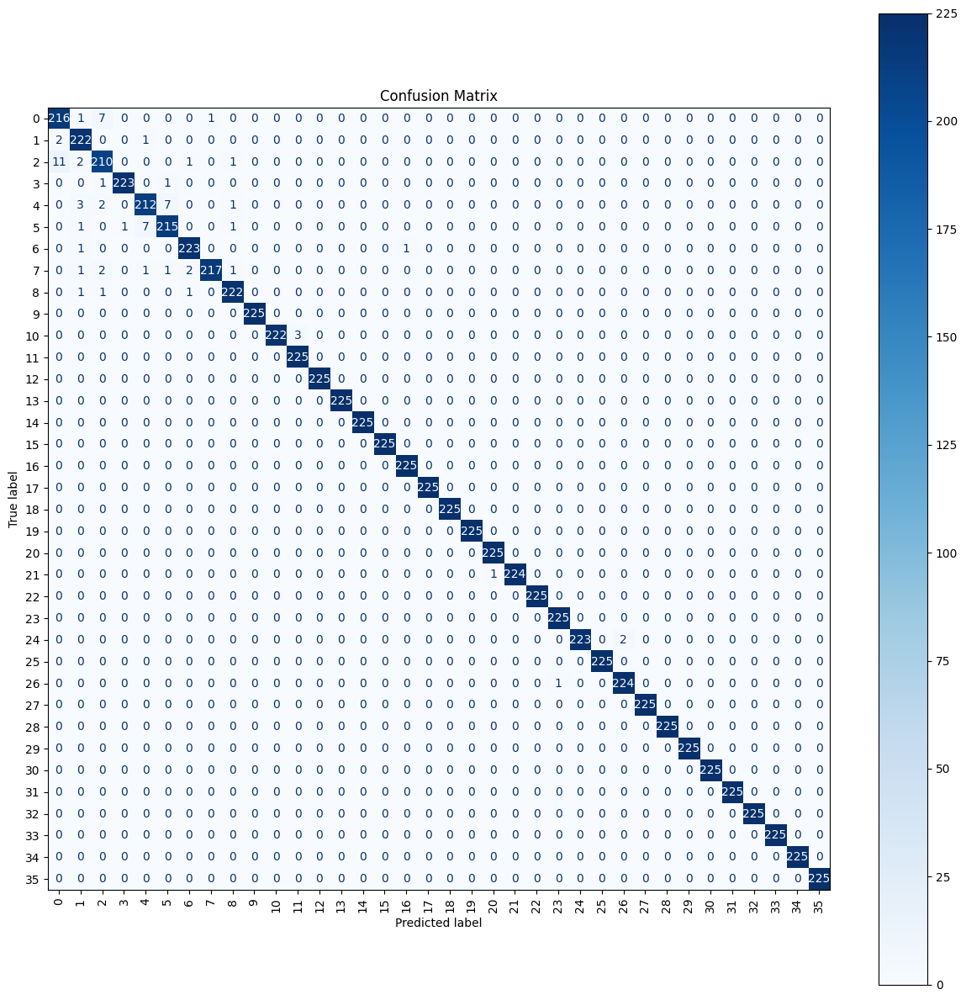

In [ ]:
true_labels = []
predicted_labels = []

for images, labels in test_dataset:  # Iterate through the test dataset
    predictions = model.predict(images, verbose = 0)  # Get predictions
    predicted_classes = np.argmax(predictions, axis=1)  # Convert probabilities to class indices

    true_labels.extend(labels.numpy())  # Collect true labels
    predicted_labels.extend(predicted_classes)  # Collect predicted labels

# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Set the figure size
plt.figure(figsize=(15, 15))  # Adjust the figsize as needed (width, height in inches)

# Plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)  # Adjust labels if needed
disp.plot(cmap=plt.cm.Blues, ax=plt.gca(), colorbar=True)  # Use plt.gca() to ensure it plots on the current figure

plt.title("Confusion Matrix")
plt.xticks(rotation=90)  # Rotate x-axis labels if they overlap
plt.show()

In [ ]:
report = classification_report(true_labels, predicted_labels, target_names=[str(c) for c in classes])
print(report)

              precision    recall  f1-score   support

           0       0.94      0.96      0.95       225
           1       0.96      0.99      0.97       225
           2       0.94      0.93      0.94       225
           3       1.00      0.99      0.99       225
           4       0.96      0.94      0.95       225
           5       0.96      0.96      0.96       225
           6       0.98      0.99      0.99       225
           7       1.00      0.96      0.98       225
           8       0.98      0.99      0.98       225
           9       1.00      1.00      1.00       225
          10       1.00      0.99      0.99       225
          11       0.99      1.00      0.99       225
          12       1.00      1.00      1.00       225
          13       1.00      1.00      1.00       225
          14       1.00      1.00      1.00       225
          15       1.00      1.00      1.00       225
          16       1.00      1.00      1.00       225
          17       1.00    

### **7.3 Model Inference**

In [ ]:
model_dir="/content/drive/MyDrive/tfrecords/mbnet.keras"
model = tf.keras.models.load_model(model_dir)

#### **7.3.1 Single Inference**

1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step


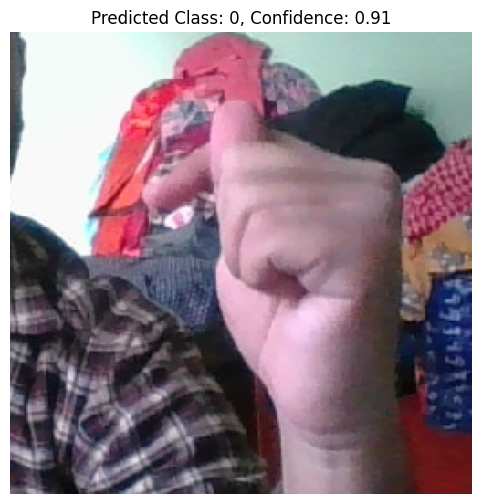

In [ ]:
image_path = "/content/drive/MyDrive/tfrecords/0.jpg"
image_size = (256, 256)

image = load_img(image_path, target_size=image_size)
image_array = img_to_array(image)
image_array = image_array / 255.0
image_array = np.expand_dims(image_array, axis=0)  # Add batch dimension -> (1, H, W, C)

# Run inference
predictions = model.predict(image_array)
predicted_class = np.argmax(predictions, axis=1)
confidence = np.max(predictions)

# Visualize the result
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.title(f"Predicted Class: {predicted_class[0]}, Confidence: {confidence:.2f}")
plt.axis("off")
plt.show()

#### **7.3.2 Batch Inference**

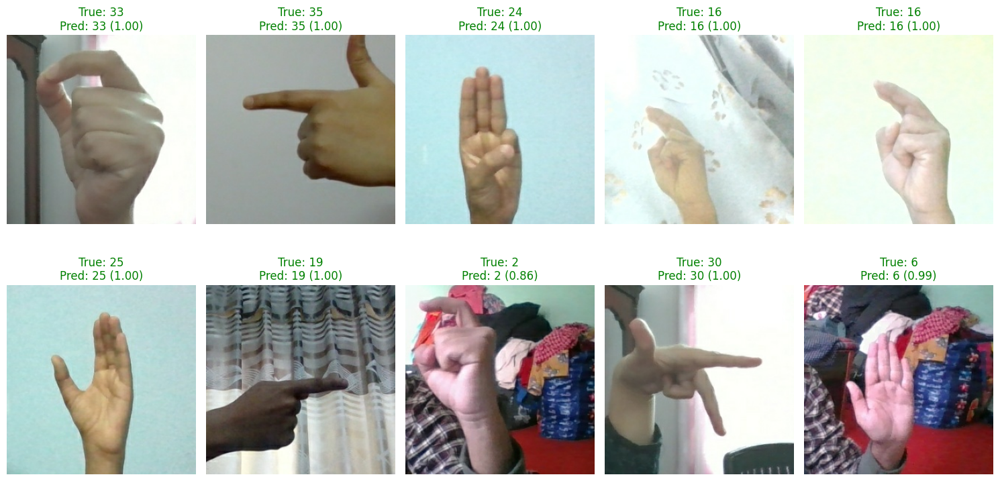

In [ ]:
sample_images, sample_labels = [], []
num_samples=10

for images, labels in test_dataset.take(1):
    sample_images = images[:num_samples]
    sample_labels = labels[:num_samples]
    break

predictions = model.predict(sample_images, verbose=0)
predicted_classes = np.argmax(predictions, axis=1)
confidences = np.max(predictions, axis=1)

fig, axes = plt.subplots(2, 5, figsize=(15, 8))
axes = axes.flatten()

for i in range(num_samples):
    axes[i].imshow(sample_images[i])
    true_label = sample_labels[i].numpy()
    pred_label = predicted_classes[i]
    confidence = confidences[i]
    color = 'green' if true_label == pred_label else 'red'
    axes[i].set_title(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## **8. ResNet50**

### **8.1 Model Training**

In [15]:
base_model = tf.keras.applications.ResNet50(
    input_shape=(256, 256, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(num_classes, activation='softmax')
])
model.summary(show_trainable=True)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ resnet50 (Functional)       │ (None, 8, 8, 2048)    │ 23,587,712 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 2048)          │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 256)           │    524,544 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 256)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 128)           │     32,896 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout_1 (Dropout)         │ (None, 128)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_2 (Dense)             │ (None, 36)            │      4,644 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 24,149,796 (92.12 MB)

 Trainable params: 562,084 (2.14 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [16]:
total_history = []

In [17]:
# Phase 1: Frozen base
optimizer = tf.keras.optimizers.Adam(learning_rate=0.005)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

history = model.fit(train_dataset, steps_per_epoch=1180, epochs=10, validation_data=val_dataset)
total_history.append(history)

Epoch 1/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 237s 186ms/step - accuracy: 0.0272 - loss: 3.6128 - val_accuracy: 0.0278 - val_loss: 3.5844
Epoch 2/10
   1/1180 ━━━━━━━━━━━━━━━━━━━━ 1:54 97ms/step - accuracy: 0.0312 - loss: 3.5772

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 216s 183ms/step - accuracy: 0.0248 - loss: 3.5854 - val_accuracy: 0.0278 - val_loss: 3.5843
Epoch 3/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 212s 180ms/step - accuracy: 0.0253 - loss: 3.5855 - val_accuracy: 0.0278 - val_loss: 3.5845
Epoch 4/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 261s 222ms/step - accuracy: 0.0255 - loss: 3.5856 - val_accuracy: 0.0278 - val_loss: 3.5846
Epoch 5/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 209s 177ms/step - accuracy: 0.0253 - loss: 3.5858 - val_accuracy: 0.0278 - val_loss: 3.5845
Epoch 6/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 210s 178ms/step - accuracy: 0.0246 - loss: 3.5855 - val_accuracy: 0.0278 - val_loss: 3.5843
Epoch 7/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 210s 178ms/step - accuracy: 0.0263 - loss: 3.5853 - val_accuracy: 0.0278 - val_loss: 3.5844
Epoch 8/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 210s 178ms/step - accuracy: 0.0267 - loss: 3.5854 - val_accuracy: 0.0278 - val_loss: 3.5845
Epoch 9/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 210s 178ms/step - accuracy: 0.0

In [18]:
print(len(base_model.layers))

175


In [19]:
# Phase 2: Partial unfreezing
for layer in base_model.layers[140:]:
    layer.trainable = True
optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

history = model.fit(train_dataset, steps_per_epoch=1180, epochs=10, validation_data=val_dataset)
total_history.append(history)

Epoch 1/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 302s 233ms/step - accuracy: 0.1056 - loss: 3.3303 - val_accuracy: 0.5153 - val_loss: 2.2588
Epoch 2/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 318s 270ms/step - accuracy: 0.3234 - loss: 2.5776 - val_accuracy: 0.6094 - val_loss: 1.7845
Epoch 3/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 273s 231ms/step - accuracy: 0.4374 - loss: 2.1470 - val_accuracy: 0.6940 - val_loss: 1.3773
Epoch 4/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 297s 252ms/step - accuracy: 0.5503 - loss: 1.7108 - val_accuracy: 0.7879 - val_loss: 0.8728
Epoch 5/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 269s 228ms/step - accuracy: 0.6553 - loss: 1.3087 - val_accuracy: 0.8602 - val_loss: 0.5977
Epoch 6/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 268s 227ms/step - accuracy: 0.7255 - loss: 1.0150 - val_accuracy: 0.9088 - val_loss: 0.4048
Epoch 7/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 268s 227ms/step - accuracy: 0.7872 - loss: 0.7829 - val_accuracy: 0.9384 - val_loss: 0.2643
Epoch 8/10
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 269s 228ms/step - ac

In [20]:
# Save model
model_dir = "/content/drive/MyDrive/tfrecords/resnet50.keras"
model.save(model_dir)
print(f"Model saved to {model_dir}")

Model saved to /content/drive/MyDrive/tfrecords/resnet50.keras


### **8.2 Model Evaluation**

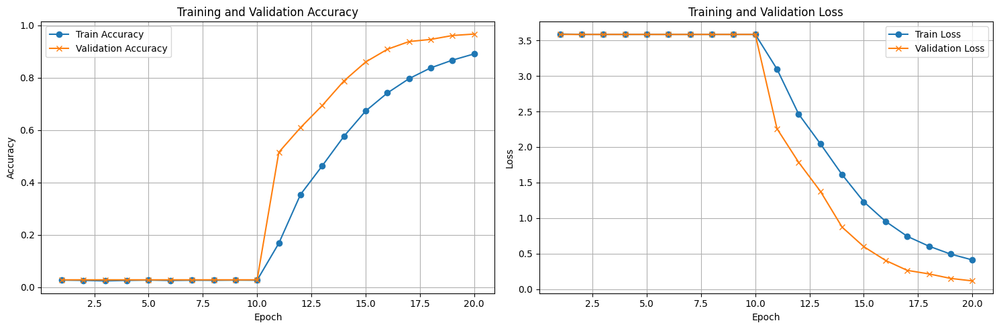

In [21]:
# Plot training curves
train_acc, val_acc, train_loss, val_loss, epochs = [], [], [], [], []
epoch_counter = 0

for history in total_history:
    acc = history.history['accuracy']
    val = history.history['val_accuracy']
    loss = history.history['loss']
    val_l = history.history['val_loss']
    n = len(acc)

    train_acc.extend(acc)
    val_acc.extend(val)
    train_loss.extend(loss)
    val_loss.extend(val_l)
    epochs.extend(range(epoch_counter + 1, epoch_counter + n + 1))
    epoch_counter += n

# Plot metrics
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

ax1.plot(epochs, train_acc, label='Train Accuracy', marker='o')
ax1.plot(epochs, val_acc, label='Validation Accuracy', marker='x')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax1.set_title('Training and Validation Accuracy')
ax1.legend()
ax1.grid(True)

ax2.plot(epochs, train_loss, label='Train Loss', marker='o')
ax2.plot(epochs, val_loss, label='Validation Loss', marker='x')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.set_title('Training and Validation Loss')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()

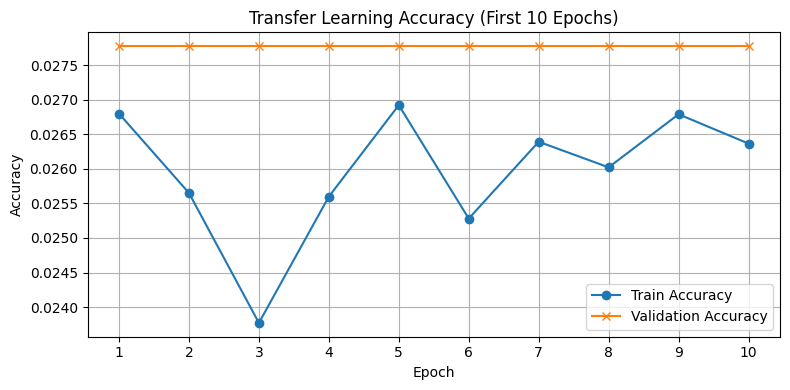

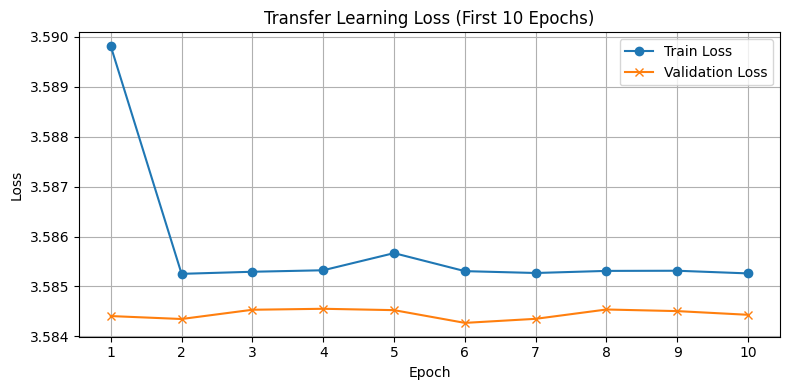

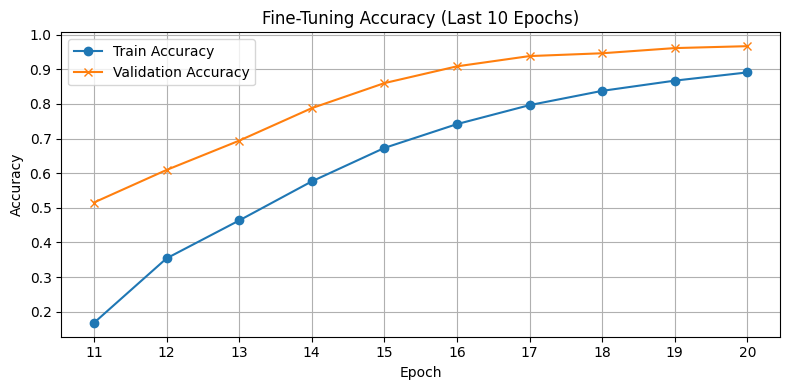

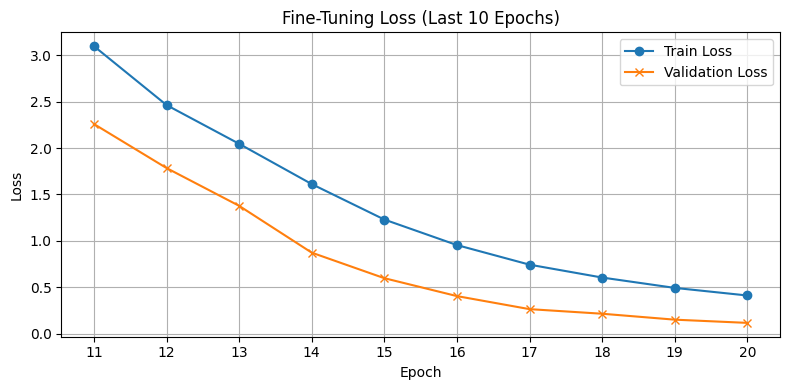

In [22]:
# Seperate plots for transfer learning and fine-tuning
# Split into two phases
split_epoch = 10  # first 10 transfer learning, next 10 fine-tuning

train_acc_phase1 = train_acc[:split_epoch]
val_acc_phase1 = val_acc[:split_epoch]
train_loss_phase1 = train_loss[:split_epoch]
val_loss_phase1 = val_loss[:split_epoch]

train_acc_phase2 = train_acc[split_epoch:]
val_acc_phase2 = val_acc[split_epoch:]
train_loss_phase2 = train_loss[split_epoch:]
val_loss_phase2 = val_loss[split_epoch:]

epochs_phase1 = epochs[:split_epoch]
epochs_phase2 = epochs[split_epoch:]

# Plot Phase 1 - Accuracy
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase1, train_acc_phase1, label='Train Accuracy', marker='o')
plt.plot(epochs_phase1, val_acc_phase1, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Transfer Learning Accuracy (First 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, split_epoch + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 1 - Loss
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase1, train_loss_phase1, label='Train Loss', marker='o')
plt.plot(epochs_phase1, val_loss_phase1, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Transfer Learning Loss (First 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(1, split_epoch + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 2 - Accuracy
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase2, train_acc_phase2, label='Train Accuracy', marker='o')
plt.plot(epochs_phase2, val_acc_phase2, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Fine-Tuning Accuracy (Last 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(split_epoch+1, split_epoch*2 + 1, 1))
plt.tight_layout()
plt.show()

# Plot Phase 2 - Loss
plt.figure(figsize=(8, 4))
plt.plot(epochs_phase2, train_loss_phase2, label='Train Loss', marker='o')
plt.plot(epochs_phase2, val_loss_phase2, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Fine-Tuning Loss (Last 10 Epochs)')
plt.legend()
plt.grid(True)
plt.xticks(np.arange(split_epoch+1, split_epoch*2 + 1, 1))
plt.tight_layout()
plt.show()

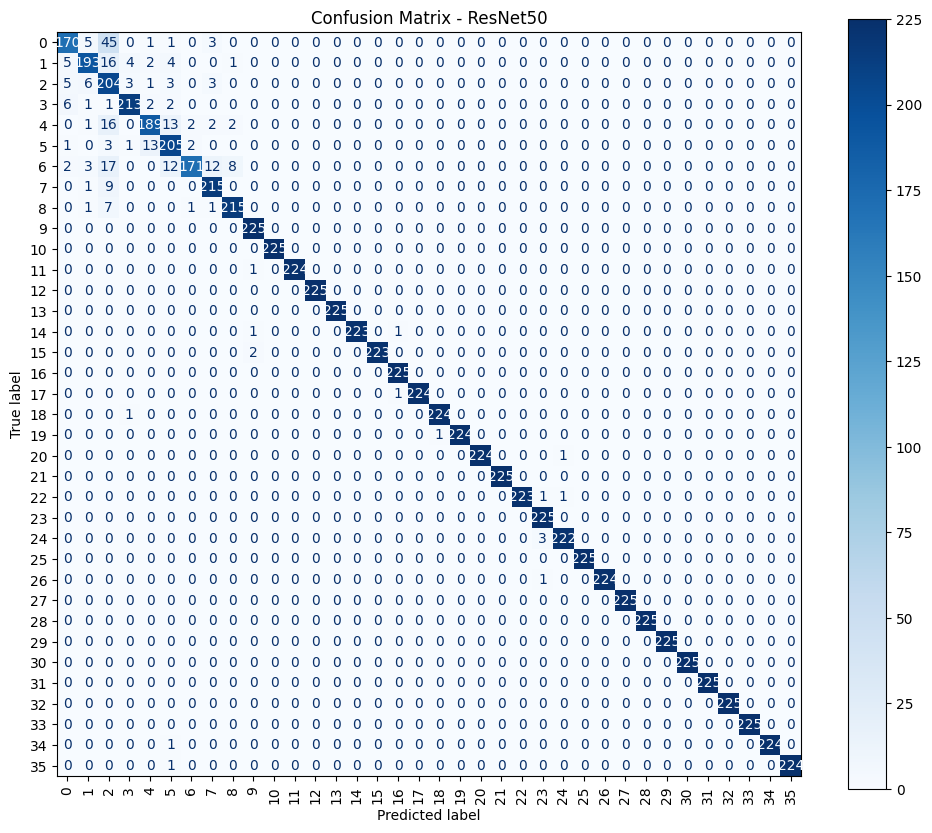

In [23]:
# Generate confusion matrix
true_labels, predicted_labels = [], []
for images, labels in val_dataset:
    predictions = model.predict(images, verbose=0)
    predicted_classes = np.argmax(predictions, axis=1)
    true_labels.extend(labels.numpy())
    predicted_labels.extend(predicted_classes)

cm = confusion_matrix(true_labels, predicted_labels)
plt.figure(figsize=(12, 10))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)
disp.plot(cmap=plt.cm.Blues, ax=plt.gca(), colorbar=True)
plt.title("Confusion Matrix - ResNet50")
plt.xticks(rotation=90)
plt.show()

In [24]:
report = classification_report(true_labels, predicted_labels, target_names=[str(c) for c in classes])
print(report)

              precision    recall  f1-score   support

           0       0.90      0.76      0.82       225
           1       0.91      0.86      0.89       225
           2       0.64      0.91      0.75       225
           3       0.96      0.95      0.95       225
           4       0.91      0.84      0.87       225
           5       0.85      0.91      0.88       225
           6       0.97      0.76      0.85       225
           7       0.91      0.96      0.93       225
           8       0.95      0.96      0.95       225
           9       0.98      1.00      0.99       225
          10       1.00      1.00      1.00       225
          11       1.00      1.00      1.00       225
          12       1.00      1.00      1.00       225
          13       1.00      1.00      1.00       225
          14       1.00      0.99      1.00       225
          15       1.00      0.99      1.00       225
          16       0.99      1.00      1.00       225
          17       1.00    

### **8.3 Model Inference**

In [25]:
model_dir = "/content/drive/MyDrive/tfrecords/resnet50.keras"
model = tf.keras.models.load_model(model_dir)

#### **8.3.1 Single Inference**

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


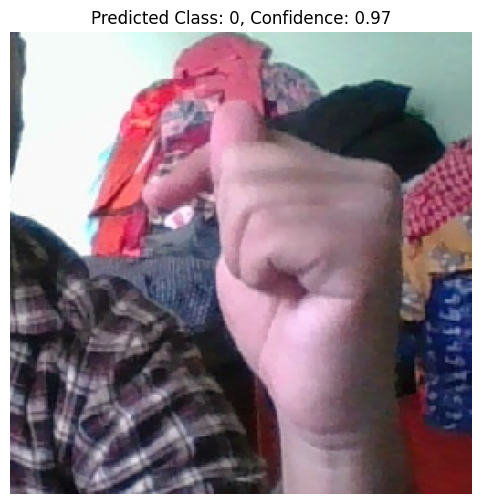

In [26]:
image_path = "/content/drive/MyDrive/tfrecords/0.jpg"
image_size = (256, 256)

image = load_img(image_path, target_size=image_size)
image_array = img_to_array(image)
image_array = image_array / 255.0
image_array = np.expand_dims(image_array, axis=0)  # Add batch dimension -> (1, H, W, C)

# Run inference
predictions = model.predict(image_array)
predicted_class = np.argmax(predictions, axis=1)
confidence = np.max(predictions)

# Visualize the result
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.title(f"Predicted Class: {predicted_class[0]}, Confidence: {confidence:.2f}")
plt.axis("off")
plt.show()

#### **8.3.2 Batch Inference**

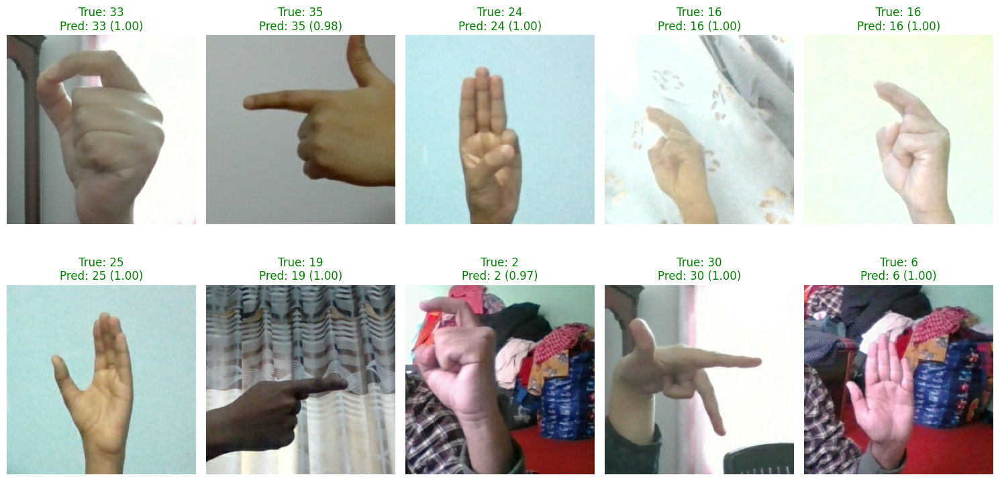

In [27]:
sample_images, sample_labels = [], []
num_samples=10

for images, labels in test_dataset.take(1):
    sample_images = images[:num_samples]
    sample_labels = labels[:num_samples]
    break

predictions = model.predict(sample_images, verbose=0)
predicted_classes = np.argmax(predictions, axis=1)
confidences = np.max(predictions, axis=1)

fig, axes = plt.subplots(2, 5, figsize=(15, 8))
axes = axes.flatten()

for i in range(num_samples):
    axes[i].imshow(sample_images[i])
    true_label = sample_labels[i].numpy()
    pred_label = predicted_classes[i]
    confidence = confidences[i]
    color = 'green' if true_label == pred_label else 'red'
    axes[i].set_title(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)
    axes[i].axis('off')

plt.tight_layout()
plt.show()